# Homework 1

Training a linear classifier on MNIST
1. Write your own algorithm from scratch
2. Use PyTorch

Andrei Dimaano, 862138653, adima009@ucr.edu

In [2]:
# installing packages
import numpy as np
import requests, gzip, os, hashlib
import matplotlib.pyplot as plt
import random
import time

# 1. Write the code for downloading and formatting the data.

In [3]:
metadata_xoffset = 16
metadata_yoffset = 8
N = 50000
N_X = N + metadata_xoffset
N_Y = N + metadata_yoffset

path = '/Users/andreidimaano/Documents/Code/cs228/dataset2'
def fetch(url):
    fp = os.path.join(path, hashlib.md5(url.encode('utf-8')).hexdigest())
    if os.path.isfile(fp):
        with open(fp, "rb") as f:
            data = f.read()
            print(data)
    else:
        with open(fp, "wb") as f:
            data = requests.get(url).content
            f.write(data)
    return np.frombuffer(gzip.decompress(data), dtype=np.uint8).copy()
    
def get_random_sample(X,Y,k):
    indices_arr = np.arange(len(X))
    r = random.choices(indices_arr, k=k)

    return X[r,:], Y[r]

def convert_to_one_hot_enc(Y):
    one_hot_enc = np.zeros((len(Y), 10))
    for i in range(len(Y)):
        one_hot_enc[i][Y[i]] = 1
    return one_hot_enc

X = fetch("http://yann.lecun.com/exdb/mnist/train-images-idx3-ubyte.gz")[metadata_xoffset:].reshape((-1, 28 * 28))
Y = fetch("http://yann.lecun.com/exdb/mnist/train-labels-idx1-ubyte.gz")[metadata_yoffset:] # first 8 bits are metadata?
X_test = fetch("http://yann.lecun.com/exdb/mnist/t10k-images-idx3-ubyte.gz")[metadata_xoffset:].reshape((-1, 28*28))
Y_test = fetch("http://yann.lecun.com/exdb/mnist/t10k-labels-idx1-ubyte.gz")[metadata_yoffset:] # first 16 bits are metadata?
X_train, Y_original = get_random_sample(X,Y,N)
Y_train = convert_to_one_hot_enc(Y_original)
X_train = X_train / np.linalg.norm(X_train)
X_test = X_test / np.linalg.norm(X_test)
Y_test = convert_to_one_hot_enc(Y_test)


b'\x1f\x8b\x08\x08z\x82\x902\x00\x03train-images.idx3-ubyte\x00\xec\x9c\x07T\x15G\xdb\xc7\'\x01\xc4\x06"v\x13\x04\x15\xc4\x86B\x8a5*F\xf3&\xc6\xa8\x18[l\x115\x891\xc6\x96\xa8\t\xbe\xf6\x12{4\xc6^\xf0\x8d\xb1\x17\x12\x01[>\xc1\x8a\x15D\x05\x11\x94^\xa4*\x9d\x0b\xec<s\xbf\xd9\xbd\xf7\xc2\xdd\x9d\x19r\x92\xf7;\xdfI\x0c\xffs\xe4\xde\xbb?gvfvw\xe6\x99g\x9eY\x84jZ \x94\xe5\x8d\x10z\xd5\xf8\xef/)\x0b{{\xfbE\xab\x7fi~H\xaf[l~\xbc\x85\xf3\xc7\xbb\x8e\x81\xac\xa4\x13Pp\xd5\xd3\x0cy<\x07\xa3\xa4\xf1\x1f~\xd8\xcd\xd5<\x99\xfd\x13\x05\\?\xa3\xcbg\xcf\xe5\xb5g\x1a@X\x1d\xd4a\x17\xa7 \xb6/\xed\x821\xc2b\xae\x83\xe0\x97E\xacN0\xfcK\x98\xb0u~\xd2\x7f\xbe|I\x00\x87\xe6\x01|\xd3L\x00\xdd~\x03\xd8\xf6\x8a\x00\xda\x8d\xc7\xf0?\xc2\x93\x96A\x99\'\x17tZv\x16 \x9cW\x13\xd7-i\xb4\xdd\xca\xcf\xb0\xa4\xe9Wqr\x93\xde\x1a\xcc\x90&o?T\x1a{(\x93\xa1\xfdq\xe5:\\\xf5\xaa\xa5%]O$\xcb\xa4he\x1d\xf6L\xab)\x88\\\xb5\xc2\x8e[\xf4\x17K\xaf\xef\x83}\xaf\xf1\x91\xfbs\x8c\xf13.\xea\x92\x0287\x13w\xaf\xc1\x90\xdao%b\xc0\xb7\x87

# 2. Write the code for minibatch SGD implementation for your linear MNIST classifier.

In [59]:
def euclidean_normalize(V):
    return np.sqrt(np.sum(np.square(V)))

intervals = 250

class LinearRegressionSGD2:
    def __init__(self, X_train = None, Y_train = None, X_test = None, Y_test = None) -> None:
        self.X_train = X_train
        self.Y_train = Y_train
        self.X_test = X_test
        self.Y_test = Y_test
        self.learned_weights = None
        self.iteration_plot_values = []
        self.test_accuracy_percentages = {} # batch size -> accuracy[]
        self.loss_values = {} # batch size -> loss values[]
        self.training_times={} # Batch Size -> training time
        
    def train_minibatch_sgd(self, ITR, B, eta, plot_error = False, plot_loss= False):
        indices_arr = np.arange(len(self.X_train))
        self.learned_weights = np.zeros((28 * 28, 10))
        loss, accuracy, j = [], [], 1
        start_time = time.time()

        if plot_loss and plot_error :
            t_loss = 0.5 * np.square(np.linalg.norm((self.Y_train - self.X_train @ self.learned_weights), ord="fro"))
            loss.append(t_loss)
            t_accuracy = self.get_test_accuracy()
            accuracy.append(t_accuracy)
        
        for i in range(ITR):
            r = random.choices(indices_arr, k=B)
            x_batch = self.X_train[r,:]
            y_batch = self.Y_train[r,:]

            gradient = x_batch.T @  (x_batch @ self.learned_weights - y_batch)
                       # remove 1/B so that I can keep eta constant
                       # because update is a function of eta/B
            self.learned_weights -= eta * gradient
            
            if i % intervals == 0:
                if plot_loss:
                    # t_loss = 0.5 * np.square(np.linalg.norm((self.Y_train - self.X_train @ self.learned_weights), ord="fro"))
                    loss.append(0.5 * np.square(np.linalg.norm((self.Y_train - self.X_train @ self.learned_weights), ord="fro")))
                if plot_error:
                    # t_accuracy = self.get_test_accuracy()
                    # print("accuracy:", t_accuracy)
                    accuracy.append(self.get_test_accuracy())
    
            # j += 1  
        
        end_time = time.time()
        self.training_times[B] = end_time - start_time
        self.loss_values[B] = loss
        self.test_accuracy_percentages[B] = accuracy

    def get_loss_and_accuracy(self):
        return self.loss_values, self.test_accuracy_percentages     

    def get_training_time(self):
        return self.training_times  

    def predict_minibatch_sgd(self, X):
        return (X @ self.learned_weights).argmax()

    def get_test_accuracy(self):
        correctly_identified = 0
        for i in range(len(self.Y_test)):
            if self.Y_test[i].argmax() == self.predict_minibatch_sgd(self.X_test[i]) :
                correctly_identified += 1
        return correctly_identified / len(self.Y_test)
    
    def plot_loss_and_accuracy(self, ITRs, ):
        _, axs = plt.subplots(1,2, figsize=(10,5))
        sorted_batch_sizes = sorted(self.loss_values.keys())
        for batch_size in sorted_batch_sizes:
            x_values = np.arange(ITRs[batch_size] + intervals, step=intervals)
            axs[0].plot(x_values, self.loss_values[batch_size], label=f'batch size {batch_size}')

        axs[0].set_xlabel('iterations')
        axs[0].set_ylabel('loss')
        axs[0].set_title('Training Loss')
        axs[0].legend()
        
        sorted_batch_sizes = sorted(self.test_accuracy_percentages.keys())
        for batch_size in sorted_batch_sizes:
            x_values = np.arange(ITRs[batch_size] + intervals, step=intervals)
            axs[1].plot(x_values, self.test_accuracy_percentages[batch_size], label=f'batch size {batch_size}')
        
        axs[1].set_xlabel('iterations')
        axs[1].set_ylabel('accuracy')
        axs[1].set_title('Test Accuracy')
        axs[1].legend()
        
        plt.show()

    def plot_training_loss(self, ITR):
        x_values = np.arange(ITR + 50, step=50)
        sorted_batch_sizes = sorted(self.loss_values.keys())
        for batch_size in sorted_batch_sizes:
            plt.plot(x_values, self.loss_values[batch_size], label=f'batch size {batch_size}')

        plt.xlabel('iterations')
        plt.ylabel('loss')
        plt.title('Training Loss')
        plt.legend()
        plt.show()
    
    def plot_test_accuracy(self, ITR):
        x_values = np.arange(ITR + intervals, step=intervals)
        sorted_batch_sizes = sorted(self.test_accuracy_percentages.keys())
        for batch_size in sorted_batch_sizes:
            plt.plot(x_values, self.test_accuracy_percentages[batch_size], label=f'batch size {batch_size}')
        
        plt.xlabel('iterations')
        plt.ylabel('accuracy')
        plt.title('Test Accuracy')
        plt.legend()
        plt.show()

    def report_training_times(self):
        print("training times:")
        for batch_size, training_time in self.training_times.items():
            print(f'batch size {batch_size}: {training_time}')

    def report_final_loss(self):
        print("final losses:")
        sorted_batch_sizes = sorted(self.loss_values.keys())
        for batch_size in sorted_batch_sizes:
            print(f'batch size {batch_size}: {self.loss_values[batch_size][-1]}')
    def report_final_accuracy(self):
        print("final accuracies:")
        sorted_batch_sizes = sorted(self.test_accuracy_percentages.keys())
        for batch_size in sorted_batch_sizes:
            print(f'batch size {batch_size}: {self.test_accuracy_percentages[batch_size][-1]}')

# 3. Role of Batch Size - Experiment

...
...
...
...


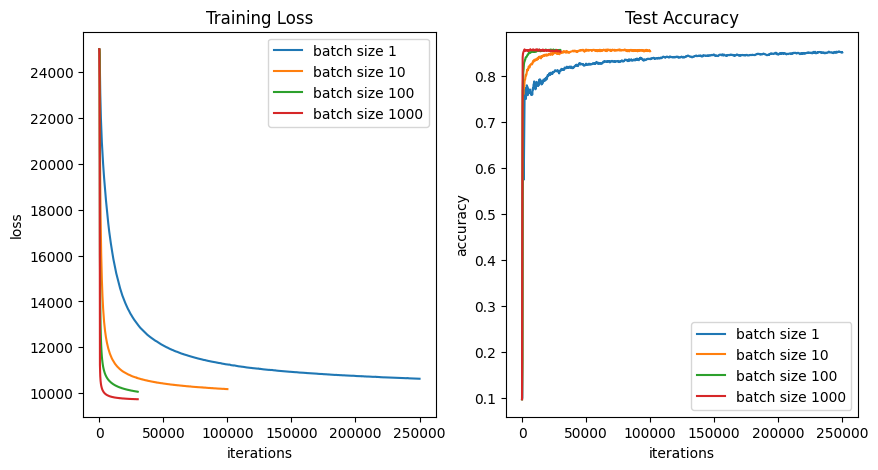

training times:
batch size 1: 165.65637493133545
batch size 10: 69.19717621803284
batch size 100: 33.246673822402954
batch size 1000: 141.76562809944153
............
final losses:
batch size 1: 10631.409618416505
batch size 10: 10179.36466981122
batch size 100: 10065.08211633123
batch size 1000: 9738.873092864473
............
final accuracies:
batch size 1: 0.8502
batch size 10: 0.853
batch size 100: 0.8554
batch size 1000: 0.8523


In [60]:
def batch_size_experiment2(B, ITR, eta, X_train, Y_train, X_test, Y_test):
    sgd = LinearRegressionSGD2(X_train, Y_train,X_test, Y_test)
    for i in range(len(B)):
        sgd.train_minibatch_sgd(ITR[B[i]], B[i], eta[i], True, True)
        print("...")

    # sgd.plot_test_accuracy(ITR)
    # sgd.plot_training_loss(ITR)
    sgd.plot_loss_and_accuracy(ITR)
    sgd.report_training_times()
    print("............")
    sgd.report_final_loss()
    print("............")
    sgd.report_final_accuracy()
    

# ITR = 5000
ITR = {1:250000, 10:100000, 100:30000, 1000:30000}
eta = [100, 80, 40, 40]
B = [1, 10, 100, 1000]
batch_size_experiment2(B, ITR, eta, X_train, Y_train, X_test, Y_test)

...
...
...
...


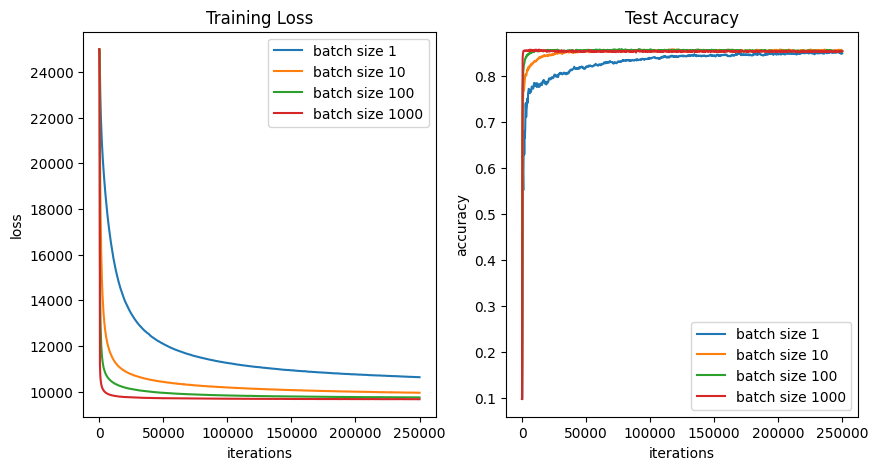

training times:
batch size 1: 173.72004890441895
batch size 10: 179.55984210968018
batch size 100: 351.8582389354706
batch size 1000: 1257.1758642196655
............
final losses:
batch size 1: 10632.356804908552
batch size 10: 9951.626024238221
batch size 100: 9747.458152763445
batch size 1000: 9669.292876678628
............
final accuracies:
batch size 1: 0.8493
batch size 10: 0.8543
batch size 100: 0.8537
batch size 1000: 0.8534


In [72]:
# ITR = 5000
ITR = {1:250000, 10:250000, 100:250000, 1000:250000}
eta = [100, 80, 40, 40]
B = [1, 10, 100, 1000]
batch_size_experiment2(B, ITR, eta, X_train, Y_train, X_test, Y_test)

# 4. Role of Batch Size Analysis

As batch size increased, the **rate at which loss decreased went up**, and the **time to converge reduced**. Increasing the batch size leads to a larger sample during each weight update. However, larger batches are **more computationally expensive**, leading to longer training times. As we can see from batch sizes 100 to 1000, the accuracy increased by < 1%. But the training time increase is about 1.7x.

If the number of iterations is small, a large batch size helps the model **converge faster**. As the batch size increases, the model loss decreases faster. So, if we want to train the model on a few iterations to save on computation, large batch sizes will help the model converge more quickly.

# 5. Role of Training Dataset Size

sample experiment for 100 done
sample experiment for 500 done
sample experiment for 1000 done
sample experiment for 10000 done
initial loss
sample size: 100: 50.0
sample size: 500: 250.00000000000003
sample size: 1000: 500.0
sample size: 10000: 5000.0
............
final loss
sample size: 100: 18.117047623224817
sample size: 500: 111.60019188153328
sample size: 1000: 225.95453773101772
sample size: 10000: 2264.907181019846
............
final accuracy
sample size: 100: 0.619
sample size: 500: 0.7935
sample size: 1000: 0.8001
sample size: 10000: 0.8423
............
training time
sample size: 100: 96.26492881774902
sample size: 500: 217.4160680770874
sample size: 1000: 101.66387987136841
sample size: 10000: 348.1730148792267


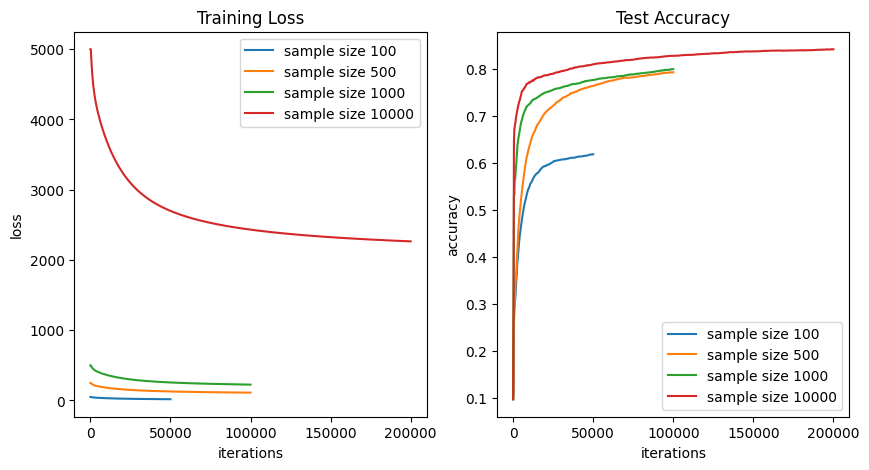

In [67]:
# Let us reduce the training dataset size. Instead of
# N = 50, 000, let us pick a subset S′ of size N ′ from the original dataset without replacement and
# uniformly at random. Fix batch size to B = 100. Repeat the steps above for N ′ ∈ {100, 500, 1000, 10000}.
# Comment on the accuracy as a function of dataset size.
def sample_size_experiment(B, N):
    ITR = 5000
    eta = 40
    loss = {}
    accuracy = {}
    times = {}
    ITR = [50000, 100000, 100000, 200000]
    for i in range(len(N)):  
        X_train_sample_n, Y_original_sample_n = get_random_sample(X,Y,N[i])
        Y_train_sample_n = convert_to_one_hot_enc(Y_original_sample_n)
        X_train_sample_n = X_train_sample_n / np.linalg.norm(X_train_sample_n)

        sgd = LinearRegressionSGD2(X_train_sample_n, Y_train_sample_n,X_test, Y_test)
        sgd.train_minibatch_sgd(ITR[i], B, N[i] / (eta * 2500), True, True)
        t_loss, t_accuracy = sgd.get_loss_and_accuracy()
        loss[N[i]], accuracy[N[i]] = t_loss[B], t_accuracy[B]
        times[N[i]] = sgd.get_training_time()
        print(f'sample experiment for {N[i]} done')  
    

    _, axs = plt.subplots(1,2, figsize=(10,5))
    sorted_sample_sizes = sorted(loss.keys())
    for i in range(len(sorted_sample_sizes)):
        x_values = np.arange(ITR[i] + intervals, step=intervals)
        axs[0].plot(x_values, loss[sorted_sample_sizes[i]], label=f'sample size {sorted_sample_sizes[i]}')

    axs[0].set_xlabel('iterations')
    axs[0].set_ylabel('loss')
    axs[0].set_title('Training Loss')
    axs[0].legend()
    
    sorted_sample_sizes = sorted(accuracy.keys())
    for i in range(len(sorted_sample_sizes)):
        x_values = np.arange(ITR[i] + intervals, step=intervals)
        axs[1].plot(x_values, accuracy[sorted_sample_sizes[i]], label=f'sample size {sorted_sample_sizes[i]}')
    
    axs[1].set_xlabel('iterations')
    axs[1].set_ylabel('accuracy')
    axs[1].set_title('Test Accuracy')
    axs[1].legend()

    print("initial loss")
    for sample_size in sorted_sample_sizes:
        print(f'sample size: {sample_size}: {loss[sample_size][0]}')
    print("............")
    print("final loss")
    for sample_size in sorted_sample_sizes:
        print(f'sample size: {sample_size}: {loss[sample_size][-1]}')
    print("............")
    print("final accuracy")
    for sample_size in sorted_sample_sizes:
        print(f'sample size: {sample_size}: {accuracy[sample_size][-1]}')
    print("............")
    print("training time")
    for sample_size in sorted_sample_sizes:
        print(f'sample size: {sample_size}: {times[sample_size][B]}')
    
    plt.show()



N = [100, 500, 1000, 10000]
sample_size_experiment(100, N)

## Comment on the accuracy as a function of dataset size.

Accuracy is geometrically proportional to dataset size. As the sample size gets larger, the predictions' accuracy improves. With more training data, the dataset becomes more diverse. We can improve the model's ability to make predictions on unseen data because the model has experience with more variants of each class. 

# 6. PyTorch

Epoch 1 Loss = 0.0798
Epoch 1 Loss = 0.0721
Epoch 1 Loss = 0.0672
Epoch 1 Loss = 0.0619
Epoch 1 Loss = 0.0589
Epoch 1 Loss = 0.0586
Epoch 1 Loss = 0.0560
Epoch 1 Loss = 0.0524
Epoch 1 Loss = 0.0533
Epoch 1 Loss = 0.0569
Epoch 1 Loss = 0.0506
Epoch 1 Loss = 0.0471
epoch done
Epoch 2 Loss = 0.0515
Epoch 2 Loss = 0.0491
Epoch 2 Loss = 0.0480
Epoch 2 Loss = 0.0461
Epoch 2 Loss = 0.0493
Epoch 2 Loss = 0.0455
Epoch 2 Loss = 0.0493
Epoch 2 Loss = 0.0518
Epoch 2 Loss = 0.0454
Epoch 2 Loss = 0.0435
Epoch 2 Loss = 0.0458
Epoch 2 Loss = 0.0468
epoch done
Epoch 3 Loss = 0.0451
Epoch 3 Loss = 0.0430
Epoch 3 Loss = 0.0445
Epoch 3 Loss = 0.0444
Epoch 3 Loss = 0.0456
Epoch 3 Loss = 0.0442
Epoch 3 Loss = 0.0428
Epoch 3 Loss = 0.0449
Epoch 3 Loss = 0.0491
Epoch 3 Loss = 0.0450
Epoch 3 Loss = 0.0424
Epoch 3 Loss = 0.0417
epoch done
Epoch 4 Loss = 0.0452
Epoch 4 Loss = 0.0423
Epoch 4 Loss = 0.0443
Epoch 4 Loss = 0.0450
Epoch 4 Loss = 0.0466
Epoch 4 Loss = 0.0421
Epoch 4 Loss = 0.0425
Epoch 4 Loss = 0.0410

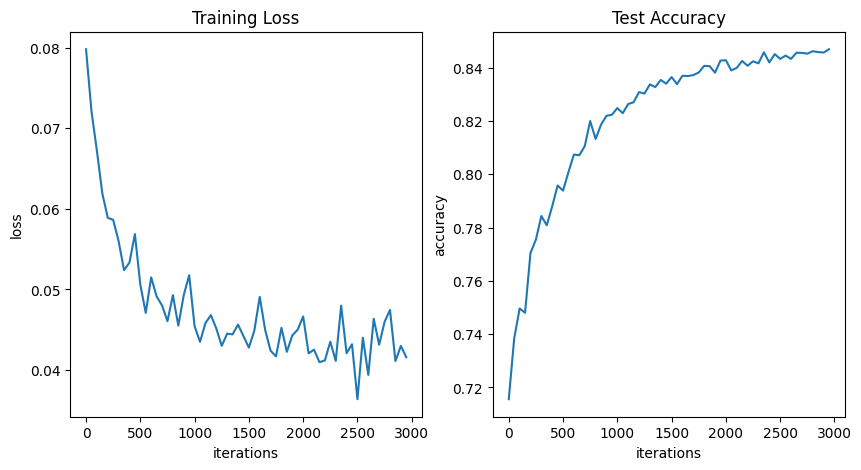

In [71]:
import torch
from torch import nn
import torchvision.transforms as transforms
import torchvision.datasets as datasets

transform = transforms.Compose([transforms.ToTensor(),
                                transforms.Normalize((0.5,), (0.5,))])

train_dataset = datasets.MNIST('data',train=True, download=True, transform=transform)
test_dataset = datasets.MNIST('data',train=True, download=True, transform=transform)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=100, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=100, shuffle=True)

def get_accuracy(dataset, model):
    correctly_predicted = 0
    for (inputs, labels) in dataset:
        inputs = inputs.view(-1, 784)
        _, prediction = torch.max(model(inputs), 1)
        correctly_predicted += (prediction == labels).sum().item()
        
    # print(f'accuracy: {correctly_predicted / len(dataset)}')
    return correctly_predicted / len(dataset)


def train_model():
    model = nn.Linear(28 * 28, 10)
    model.weight.data.fill_(0)
    loss_fn = nn.MSELoss()
    optimizer = torch.optim.SGD(model.parameters(), lr=0.0015)

    losses = []
    accuracy = []
    xvalues = 0

    for epoch in range(5):
        start_time = time.time()
        # iterations = 0
        for inputs, labels in train_loader:
            inputs = inputs.view(-1,784)
            prob_dist = nn.functional.one_hot(labels, num_classes=10).float()

            loss = loss_fn(model(inputs), prob_dist)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            xvalues += 1
            if  xvalues % 50 == 0: 
                print(f"Epoch {epoch + 1} Loss = {loss.item():.4f}")
                # ploss.item()
                losses.append(loss.item())
                accuracy.append(get_accuracy(test_dataset, model))
        print("epoch done")
            
    end_time = time.time()
    _, axs = plt.subplots(1,2, figsize=(10,5))
    x_values = np.arange(xvalues, step=50)
    
    axs[0].plot(x_values, losses)
    axs[0].set_xlabel('iterations')
    axs[0].set_ylabel('loss')
    axs[0].set_title('Training Loss')
    
    
    
    axs[1].plot(x_values, accuracy)
    axs[1].set_xlabel('iterations')
    axs[1].set_ylabel('accuracy')
    axs[1].set_title('Test Accuracy')

    print(f'initial loss: {losses[0]}')
    print(f'final loss: {losses[-1]}')
    print(f'final accuracy: {accuracy[-1]}')
    print(f'training time: {end_time - start_time}')
    
    plt.show()    

train_model()